In [1]:
import ross as rs
import numpy as np
import pandas as pd
import plotly.graph_objects as go
from xlwings import Book
import rotor_mtm.rotor_mtm as rmtm
import rotor_mtm.results as rot_res
from copy import deepcopy
from ross import Q_
from pickle import dump, load

In [ ]:
# XLTRC2_filename = "compressor_train.xls" 

# wb = Book(XLTRC2_filename)

# n_lines = 0

# while wb.sheets['Model'][20+n_lines,0].value != None:
#     n_lines += 1

# n_lines = 54

# model = wb.sheets['Model']['A21:K'+str(20+n_lines)].value
# model = np.array(model)
# model[:,10] = model[:,10]==1

# mat = []

# for i in range(10):
#     if wb.sheets['Model']['K'+str(5+i)].value != None:
#         mat.append(rs.Material(name="Mat"+str(i+1), rho=wb.sheets['Model']['N'+str(5+i)].value,
#                                      E=wb.sheets['Model']['O'+str(5+i)].value,
#                                      G_s=wb.sheets['Model']['P'+str(5+i)].value))

# shaft = [
#     rs.ShaftElement(
#         n=int(model[i,1])-1,
#         L=model[i,4],
#         odl=model[i,5],
#         idl=model[i,6],
#         odr=model[i,7],
#         idr=model[i,8],
#         material=mat[int(model[i,9]-1)],
#         shear_effects=model[i,10],
#         rotary_inertia=True,
#         gyroscopic=True,
#     )
#     for i in range(n_lines)
# ]



# disks_total = rs.DiskElement.from_table(file=XLTRC2_filename,sheet_name="More")
# disks = [d for d in disks_total if d.n < 55]

# brg1 = rs.BearingElement(kxx=1.850e7,kxy=-1.000e6,kyx=-2.300e6,kyy=1.500e7,
#                              cxx=1.200e4,cxy=-1.800e3,cyx=-1.500e3,cyy=9.600e3,n=21)

# brg2 = rs.BearingElement(kxx=1.850e7,kxy=-1.000e6,kyx=-2.300e6,kyy=1.500e7,
#                              cxx=1.200e4,cxy=-1.800e3,cyx=-1.500e3,cyy=9.600e3,n=33)

# # seal1 = rs.SealElement(kxx=0,kxy=1.2e6,kyx=-1.2e6,kyy=0,
# #                              cxx=0,cxy=0,cyx=0,cyy=0,n=0)
# # seal2 = rs.SealElement(kxx=0,kxy=1.2e6,kyx=-1.2e6,kyy=0,
# #                              cxx=0,cxy=0,cyx=0,cyy=0,n=54)

# sp_arr = Q_(np.arange(1000, 40000, 500), "RPM")

# rotor = rs.Rotor(shaft,disks,[brg1,brg2])

# rotor.save('compressor_rotor.toml')

In [2]:
# sp_arr = Q_(np.arange(1000, 40000, 500), "RPM")
sp_arr = Q_(np.arange(2000, 30000, 50), "RPM")

rotor_original = rs.Rotor.load('compressor_rotor.toml')

with open('rotor_dict_v3.pic', 'rb') as file:
    rotor_dict = load(file)

with open('linear_results_dict.pic', 'rb') as file:
    linres_dict = load(file)

lin_res = linres_dict['lin_res']
rig_res = linres_dict['rig_res']
lin_res_var = linres_dict['lin_res_var']   

r = rotor_dict['r_det_transtun']
r_var = rotor_dict['r_var1_transtun']

In [ ]:
r.

In [17]:
b1 = MaxBrg(
    n=21,
    frequency=sp_arr,
    probes=[(1, 80, Q_(3.93701e-2, "in")), (2, 80, Q_(3.93701e-2, "in"))],
    total_ex_film=10,
    total_ey_film=10,
    total_ez_film=10,
    total_ey_pad=6,
    bearing_type="conventional_tilting_pad",
    operating_type="regular_flooded",
    thermal_type="full",
    temp_j_type="averaged_film_temperature",
    deform_type="pad_mechanical_thermal_shaft_shell_thermal",
    equilibrium_type="match_load",
    sump_type="supply_temperature",
    journal_diameter=Q_(44.45, "mm"),
    radial_clearance=Q_(0.111 / 2, "mm"),
    pad_thickness=Q_(10, "mm"),
    pivot_angle=Q_([45, 135, 225, 315], "deg"),
    pad_arc=Q_([72, 72, 72, 72], "deg"),
    pad_axial_length=Q_([19.1, 19.1, 19.1, 19.1], "mm"),
    preload=[0.25, 0.25, 0.25, 0.25],
    offset=[0.5, 0.5, 0.5, 0.5],
    lubricant="ISOVG32",
    pivot_type="rocker_back",
    ambient_temperature="supply_temperature",
    pad_convection=Q_(0.00025, "BTU/(s*in²*degF)"),
    pad_E=Q_(200, "GPa"),
    pad_poisson=0.3,
    pad_conductivity=Q_(0.00067, "BTU/(in*s*degF)"),
    pad_expansion=Q_(6.5e-6, "1/degF"),
    pad_density=Q_(7.322e-4, "lbf*s²/in⁴"),
    journal_expansion=Q_(6.5e-6, "1/degF"),
    shell_expansion=Q_(6.5e-6, "1/degF"),
    weight=Q_(455, "N"),
    oil_flow_v=Q_(8.2, "liter/min"),
    ambient_pressure_1=Q_(1, "atm"),
    ambient_pressure_2=Q_(1, "atm"),
    oil_supply_temperature=Q_(45, "degC"),
    shell_id=Q_(65, "mm"),
    shell_od=Q_(70, "mm"),
    journal_temperature=Q_(80, "degC"),
    starv_number=2,
)

b2 = deepcopy(b1)
b2.n = 33


In [6]:
r.rotor_solo_disks.bearing_elements[1]

MaxBrg(n=21, n_link=None,
 kxx=[37300242.74829261 31596449.2877325  28331255.96262756 26169441.05392264
 24545052.09359395 23306270.53362359 22383417.78443788 21645241.75573317
 20987539.24418103 20440481.31986624 20017175.13186431 19607517.89158439
 19250242.72954077 19553121.85474275 19800292.86001715 19983141.69415527
 20156288.77525643 20339710.8761443  20548192.53261323 20766545.59624078
 21004430.77471191 21300556.5713297  21569991.9437132  21834611.32812743
 22135692.66691133 22504869.61285971 22840665.74219602 23188057.18347542
 23550665.50492365 23925609.32282956 24312552.06530664 24724288.93675511
 25131675.00089043 25543332.51799168 25962780.44290459 26391444.41752236
 26830361.52107244 27278891.44606347 27737540.41850359 28204592.74267874
 28681703.91445336 29166816.1935133  29657981.29381645 30160759.49238189
 30670050.22013304 31230940.4280755  31759823.47051986 32295853.87692771
 32839488.61888478 33390697.59646627 33949650.46379381 34514910.63354702
 35088516.69154245 3

In [18]:
cross_coupling = 1.2e6
seal1 = rs.SealElement(kxx=0,kxy=cross_coupling,kyx=-cross_coupling,kyy=0,
                             cxx=0,cxy=0,cyx=0,cyy=0,n=0)
seal2 = rs.SealElement(kxx=0,kxy=cross_coupling,kyx=-cross_coupling,kyy=0,
                             cxx=0,cxy=0,cyx=0,cyy=0,n=54)

rotor = rs.Rotor(shaft_elements=rotor_original.shaft_elements,
                 disk_elements=rotor_original.disk_elements,
                 bearing_elements=[b1, b2, seal1, seal2])


In [68]:
sp_arr = Q_(np.arange(1000, 30000, 500), "RPM")
# camp = r.rotor_solo.run_campbell(speed_range=sp_arr)
camp_disks = r.rotor_solo_disks.run_campbell(speed_range=sp_arr)

In [ ]:
fig_camp = camp_disks.plot()
fig_camp.update_layout(width=700, height=700)
fig_camp.layout.yaxis.range = [0, 30000]
fig_camp.add_trace(go.Scatter(x=[10000, 10000],
                              y=[0, 30000],
                              showlegend=False,
                              mode='lines',
                              line=dict(color='black', width=2, dash='dash'),))
fig_camp.add_trace(go.Scatter(x=[20000, 20000],
                              y=[0, 30000],
                              showlegend=False,
                              mode='lines',
                              line=dict(color='black', width=2, dash='dash'),))
fig_camp.data[0].showlegend = False
fig_camp.data[15].showlegend = False
rot_res.IntegrationResults._adjust_plot(fig_camp, font_size=28)
fig_camp.show()
# fig_camp.write_image('campbell_rotor_solo_disks.pdf')
# fig_camp.write_html('campbell_rotor_solo_disks.html')

In [72]:
r.rotor_solo_disks.disk_elements

[DiskElement(Id=2.945e-06, Ip=5.891e-06, m=0.09953, color='Firebrick', n=1, scale_factor=1, tag='Disk 0'),
 DiskElement(Id=0.004796, Ip=0.007604, m=3.462, color='Firebrick', n=3, scale_factor=1, tag='Disk 1'),
 DiskElement(Id=9.571e-05, Ip=0.0001914, m=0.4136, color='Firebrick', n=7, scale_factor=1, tag='Disk 2'),
 DiskElement(Id=0.001, Ip=0.002001, m=1.5, color='Firebrick', n=14, scale_factor=1, tag='Disk 3'),
 DiskElement(Id=0.000439, Ip=0.0008779, m=0.4714, color='Firebrick', n=23, scale_factor=1, tag='Disk 4'),
 DiskElement(Id=0.000951, Ip=0.001902, m=0.8928, color='Firebrick', n=24, scale_factor=1, tag='Disk 5'),
 DiskElement(Id=0.000951, Ip=0.001902, m=0.8928, color='Firebrick', n=30, scale_factor=1, tag='Disk 6'),
 DiskElement(Id=0.000439, Ip=0.0008779, m=0.4714, color='Firebrick', n=31, scale_factor=1, tag='Disk 7'),
 DiskElement(Id=0.001, Ip=0.002001, m=1.5, color='Firebrick', n=40, scale_factor=1, tag='Disk 8'),
 DiskElement(Id=9.567e-05, Ip=0.0001913, m=0.411, color='Firebri

In [73]:
mod1 = r.rotor_solo.run_modal(Q_(5715, 'rpm'))
mod2 = r.rotor_solo.run_modal(Q_(11652, 'rpm'))
mod3 = r.rotor_solo.run_modal(Q_(17929, 'rpm'))
mod4 = r.rotor_solo_disks.run_modal(Q_(12094, 'rpm'))

In [75]:
mod4.damping_ratio

array([ 0.544718  , -0.1296041 ,  0.44389989,  0.47593647,  0.02974694,
        0.36725506])

In [64]:
mod3.damping_ratio

array([ 0.46652006, -0.14627847,  0.26334907, -0.01431254,  0.52351133,
        0.5133827 ])

In [65]:
mod2.damping_ratio

array([ 0.54311103, -0.12814692,  0.3009724 ,  0.00128089,  0.72689913,
        0.72553503])

In [63]:
fig = mod2.plot_mode_2d(3)

rot_res.IntegrationResults._adjust_plot(fig, font_size=28)
fig.update_layout(width=890, height=700)
fig.show()
# fig.write_image('2nd_crit_speed.pdf')
fig = mod3.plot_mode_2d(5)
fig.update_layout(width=1000, height=700)
rot_res.IntegrationResults._adjust_plot(fig, font_size=28)
fig.update_layout(width=890, height=700)
fig.show()
# fig.write_image('3rd_crit_speed.pdf')

In [24]:
f_0 = Q_(1267, 'rad/s').to('rad/s').m #377 #10000 # 1800/60*2*np.pi # em rad/s

In [71]:
n_res = 13
# m_ratio = 0.1
i_d = 0.09
o_d = 0.15
L = 0.015
var = 0.6
p_damp = 1e-4
ge = True

rho = 7800
mr = np.pi/4*(o_d**2-i_d**2)*L * rho
Ip = 1/8*mr*(o_d**2+i_d**2)
It = 1/12*mr*(3/4*(o_d**2+i_d**2)+L**2)
dk_r = rs.DiskElement(n=0,
                      m=mr,
                      Id=It,
                      Ip=Ip)

f_0 = Q_(1267, 'rad/s').to('rad/s').m #377 #10000 # 1800/60*2*np.pi # em rad/s
f_1 = rmtm.RotorMTM.calc_f1(dk_r, f_0)

k0 = mr * f_0**2
k1 = It * f_1**2

n_pos = np.array([#16, 17, 19,
                  22, 24, 26,
                  27,
                  28, 30, 32,
                  #35, 37, 38
])
# rotor = rs.Rotor(shaft,disks,[b1, b2, seal1, seal2])

rotor_dict = dict(
                # Rotor com ressonadores rígidos
                r_rigid = rmtm.RotorMTM(rotor,n_pos,dk_r,k0*100,k1*100,var=0,var_k=0,p_damp=1e-4,ge=True),
                # Rotores com ressonadores flexurais
                r_det_flextun = rmtm.RotorMTM(rotor,n_pos,dk_r,k0*100,k1,var=0,var_k=0,p_damp=1e-4,ge=True),
                r_var1_flextun = rmtm.RotorMTM(rotor,n_pos,dk_r,k0*100,k1,var=var,var_k=0,p_damp=1e-4,ge=True,exp_var=1),
                r_var3_flextun = rmtm.RotorMTM(rotor,n_pos,dk_r,k0*100,k1,var=var,var_k=0,p_damp=1e-4,ge=True,exp_var=3),
                # Rotores com ressonadores translacionais
                r_det_transtun = rmtm.RotorMTM(rotor,n_pos,dk_r,k0,100*k1,var=0,var_k=0,p_damp=1e-4,ge=True),
                r_var1_transtun = rmtm.RotorMTM(rotor,n_pos,dk_r,k0,100*k1,var=var,var_k=0,p_damp=1e-4,ge=True,exp_var=1),
                r_var3_transtun = rmtm.RotorMTM(rotor,n_pos,dk_r,k0,100*k1,var=var,var_k=0,p_damp=1e-4,ge=True,exp_var=3),
                # Rotores com ambos os GDL sintonizados (super bandgap)
                r_det_sbg = rmtm.RotorMTM(rotor,n_pos,dk_r,k0,k1,var=0,var_k=0,p_damp=1e-4,ge=True),
                r_var3_sbg = rmtm.RotorMTM(rotor,n_pos,dk_r,k0,k1,var=var,var_k=0,p_damp=1e-4,ge=True,exp_var=3)
                )
r = rotor_dict['r_det_transtun']
r_var = rotor_dict['r_var1_transtun']
# with open('rotor_dict_v3.pic', 'wb') as file:
#     dump(rotor_dict, file)

NameError: name 'rotor' is not defined

In [8]:
modal = r.rotor_solo_disks.run_modal(Q_(12000, 'rpm'), num_modes=30)

In [11]:
modal.wd / 2 / np.pi * 60

array([  5570.79972163,   6369.70996163,  10112.61654613,  11725.4925423 ,
        12101.65387959,  12536.55351435,  32625.30040653,  38642.6928296 ,
        55243.55414256,  63340.34002498,  72256.78732641,  81050.40063212,
       128683.86573515, 136697.5957932 , 150036.20055809])

In [12]:
modal.log_dec

array([ 4.09455326, -0.81727932,  3.15528831,  3.43960456,  0.18218822,
        2.47196931,  1.74930747,  1.73424598,  0.13315032,  0.0181052 ,
        0.53291751,  0.51303716,  0.07340878,  0.066244  ,  0.03553741])

In [13]:
modal.whirl_direction()

array(['Backward', 'Forward', 'Backward', 'Forward', 'Forward',
       'Backward', 'Backward', 'Forward', 'Backward', 'Forward',
       'Backward', 'Forward', 'Backward', 'Forward', 'Backward'],
      dtype='<U8')

In [15]:
modal.plot_mode_3d(4).update_layout(width=900, height=900)

In [6]:
r = rotor_dict['r_det_transtun']
r_var = rotor_dict['r_var1_transtun']
fig = r_var.rotor_solo_disks.plot_rotor(nodes=5)
fig.write_image('rotor_turboexpander_plot.pdf')
fig.show()

In [15]:
r.rotor_solo_disks.m / r._rotor.m - 1
# dk_r.m

np.float64(0.4032505648348146)

In [45]:
sp_arr = Q_(np.arange(2000, 30000, 100), "RPM").to('rad/s').m
# probe_nodes = [4 * 21, 4 * 21 + 1, 4 * 33, 4 * 33 + 1]

res_analysis = r.run_analysis(sp_arr=sp_arr, 
    n_modes=50, 
    dof=0, 
    dof_show=0, 
    diff_lim=1e9, 
    unb_node=0, 
    probe_node=None,
    heatmap=True, 
    diff_analysis=True, 
    silent=False,
    backward_vector=False
    )
res_analysis_var = r_var.run_analysis(sp_arr=sp_arr, 
    n_modes=50,
    dof=0,
    dof_show=0,
    diff_lim=1e9,
    unb_node=0,
    probe_node=None,
    heatmap=True, 
    diff_analysis=True, 
    silent=False,
    backward_vector=False
    )

diff = res_analysis['diff']
diff = [a[:np.min([len(a) for a in diff])] for a in diff]
diff2 = res_analysis_var['diff']
diff2 = [a[:np.min([len(a) for a in diff2])] for a in diff2]


with open('results_analysis_var.pic', 'wb') as file:
    dump(res_analysis_var, file)

with open('results_analysis.pic', 'wb') as file:
    dump(res_analysis, file)

    

AttributeError: 'dict' object has no attribute 'run_analysis'

In [44]:
sp_arr = Q_(np.arange(2000, 30000, 100), "RPM").to('rad/s').m

def plot_diff_modal(res_an, mode):

    fig = rmtm.plot_diff_modal(
        w=res_an['w'], 
        sp_arr=res_an['sp_arr'], 
        diff=res_an['diff'],
        mode=mode,
        saturate=10
        )
    for d in fig.data:
        d.x = [a * 60 / (2 * np.pi) for a in d.x]
        d.y = [a * 60 / (2 * np.pi) for a in d.y]
    fig.add_trace(go.Scatter(
        x=[0, 30000],
        y=[0, 30000],
        mode='lines',
        name='Synch. frequency',
        line=dict(color='black', width=2, dash='dash'),
    ))
    rot_res.IntegrationResults._adjust_plot(fig, font_size=28)
    fig.layout.width = 900
    fig.layout.xaxis.range = [0, 30000]
    fig.layout.xaxis.tickvals = np.arange(0, 30001, 5000)
    fig.layout.xaxis.ticktext = [f'{int(a)}' for a in np.arange(0, 30001, 5000)]
    fig.layout.xaxis.title = 'Speed [rpm]'
    fig.layout.yaxis.range = [0, 30000]
    fig.layout.yaxis.tickvals = np.arange(0, 30001, 5000)
    fig.layout.yaxis.ticktext = [f'{int(a)}' for a in np.arange(0, 30001, 5000)]
    fig.layout.yaxis.title = 'Natural Frequencies [rpm]'
    # Mudar a posição da legenda um pouco para cima
    fig.layout.legend.yanchor = 'bottom'
    fig.layout.legend.y = 0.9
    # fig.show()
    return fig

name = ['', '_var']
for i, r in enumerate([res_analysis, res_analysis_var]):
    fig = plot_diff_modal(r, mode='abs')
    fig.write_image(f'diff_modal_abs{name[i]}.pdf')
    fig.show()

    fig = plot_diff_modal(r, mode='phase')
    fig.write_image(f'diff_modal_phase{name[i]}.pdf')
    fig.show()


In [ ]:
sp_arr = Q_(np.arange(2000, 30000, 50), "RPM")

# sp_arr = Q_(np.arange(1000, 3000, 50), 'rad/s')
lin_res = r.calc_frf(sp_arr=sp_arr.to('rad/s').m,
                    f=np.ones(len(sp_arr)),
                    probe_dof=[4 * 21, 4 * 21 + 1, 4 * 33, 4 * 33 + 1],
                    probe_names=['1st_imp_x', '1st_imp_y', '2nd_imp_x', '2nd_imp_y'],
                    f_node=27,
                    silent=False,
                    rotor_solo=False)
rig_res = r.calc_frf(sp_arr=sp_arr.to('rad/s').m,
                    f=np.ones(len(sp_arr)),
                    probe_dof=[4 * 21, 4 * 21 + 1, 4 * 33, 4 * 33 + 1],
                    probe_names=['1st_imp_x', '1st_imp_y', '2nd_imp_x', '2nd_imp_y'],
                    f_node=27,
                    silent=False,
                    rotor_solo=True)
lin_res_var = r_var.calc_frf(sp_arr=sp_arr.to('rad/s').m,
                    f=np.ones(len(sp_arr)),
                    probe_dof=[4 * 21, 4 * 21 + 1, 4 * 33, 4 * 33 + 1],
                    probe_names=['1st_imp_x', '1st_imp_y', '2nd_imp_x', '2nd_imp_y'],
                    f_node=27,
                    silent=False,
                    rotor_solo=False)
# with open('linear_results_dict.pic', 'wb') as file:
#     dump(dict(lin_res=lin_res,
#               rig_res=rig_res,
#               lin_res_var=lin_res_var), 
#               file)

Linear response calculated for frequency: 209.4 rad/s
Linear response calculated for frequency: 214.7 rad/s
Linear response calculated for frequency: 219.9 rad/s
Linear response calculated for frequency: 225.1 rad/s
Linear response calculated for frequency: 230.4 rad/s
Linear response calculated for frequency: 235.6 rad/s
Linear response calculated for frequency: 240.9 rad/s
Linear response calculated for frequency: 246.1 rad/s
Linear response calculated for frequency: 251.3 rad/s
Linear response calculated for frequency: 256.6 rad/s
Linear response calculated for frequency: 261.8 rad/s
Linear response calculated for frequency: 267.0 rad/s
Linear response calculated for frequency: 272.3 rad/s
Linear response calculated for frequency: 277.5 rad/s


KeyboardInterrupt: 

In [81]:
sp_arr = Q_(np.arange(2000, 30000, 50), "RPM")

# sp_arr = Q_(np.arange(1000, 3000, 50), 'rad/s')
lin_res = r.calc_frf(sp_arr=sp_arr.to('rad/s').m,
                    f=np.ones(len(sp_arr)),
                    probe_dof=[4 * 21, 4 * 21 + 1, 4 * 33, 4 * 33 + 1],
                    probe_names=['1st_imp_x', '1st_imp_y', '2nd_imp_x', '2nd_imp_y'],
                    f_node=0,
                    silent=False,
                    rotor_solo=False)
rig_res = r.calc_frf(sp_arr=sp_arr.to('rad/s').m,
                    f=np.ones(len(sp_arr)),
                    probe_dof=[4 * 21, 4 * 21 + 1, 4 * 33, 4 * 33 + 1],
                    probe_names=['1st_imp_x', '1st_imp_y', '2nd_imp_x', '2nd_imp_y'],
                    f_node=0,
                    silent=False,
                    rotor_solo=True)
lin_res_var = r_var.calc_frf(sp_arr=sp_arr.to('rad/s').m,
                    f=np.ones(len(sp_arr)),
                    probe_dof=[4 * 21, 4 * 21 + 1, 4 * 33, 4 * 33 + 1],
                    probe_names=['1st_imp_x', '1st_imp_y', '2nd_imp_x', '2nd_imp_y'],
                    f_node=0,
                    silent=False,
                    rotor_solo=False)
with open('linear_results_imp_imbal_dict.pic', 'wb') as file:
    dump(dict(lin_res=lin_res,
              rig_res=rig_res,
              lin_res_var=lin_res_var), 
              file)

Linear response calculated for frequency: 209.4 rad/s
Linear response calculated for frequency: 214.7 rad/s
Linear response calculated for frequency: 219.9 rad/s
Linear response calculated for frequency: 225.1 rad/s
Linear response calculated for frequency: 230.4 rad/s
Linear response calculated for frequency: 235.6 rad/s
Linear response calculated for frequency: 240.9 rad/s
Linear response calculated for frequency: 246.1 rad/s
Linear response calculated for frequency: 251.3 rad/s
Linear response calculated for frequency: 256.6 rad/s
Linear response calculated for frequency: 261.8 rad/s
Linear response calculated for frequency: 267.0 rad/s
Linear response calculated for frequency: 272.3 rad/s
Linear response calculated for frequency: 277.5 rad/s
Linear response calculated for frequency: 282.7 rad/s
Linear response calculated for frequency: 288.0 rad/s
Linear response calculated for frequency: 293.2 rad/s
Linear response calculated for frequency: 298.5 rad/s
Linear response calculated f

In [111]:
with open('linear_results_imp_imbal_dict.pic', 'rb')as file:
    linres_dict = load(file)

# with open('linear_results_dict.pic', 'rb')as file:
#     linres_dict = load(file)

lin_res = linres_dict['lin_res']
rig_res = linres_dict['rig_res']
lin_res_var = linres_dict['lin_res_var']

In [112]:
fig2 = rig_res.plot_frf(whirl='unbalance', 
                       frequency_units='rpm',
                       dof=['2nd_imp_x'])
fig2.add_trace(lin_res.plot_frf(whirl='unbalance', 
                               frequency_units='rpm',
                       dof=['2nd_imp_x']).data[0])
fig2.add_trace(lin_res_var.plot_frf(whirl='unbalance', 
                                   frequency_units='rpm',
                       dof=['2nd_imp_x']).data[0])


fig1 = rig_res.plot_frf(whirl='unbalance', 
                       frequency_units='rpm',
                       dof=['1st_imp_x'],)
fig1.add_trace(lin_res.plot_frf(whirl='unbalance', 
                               frequency_units='rpm',
                       dof=['1st_imp_x']).data[0])
fig1.add_trace(lin_res_var.plot_frf(whirl='unbalance', 
                                   frequency_units='rpm',
                       dof=['1st_imp_x']).data[0])


names = ['Bare rotor',
         'Periodic res.',         
         'Rainbow res.']
for i, d in enumerate(fig1.data):
    d.y = 4 * d.y * 1e-6 * 6350 * r.rotor_solo_disks.m / (f_0 * 60 / (2 * np.pi))
    d.name = names[i]
fig1.add_trace(go.Scatter(x=[10000, 10000],
                              y=[0, 100e-6],
                              showlegend=False,
                              mode='lines',
                              line=dict(color='black', width=2, dash='dash'),))
fig1.add_trace(go.Scatter(x=[20000, 20000],
                              y=[0, 100e-6],
                              showlegend=False,
                              mode='lines',
                              line=dict(color='black', width=2, dash='dash'),))
fig1.add_trace(go.Scatter(x=[10000, 20000],
                              y=[9e-6, 9e-6],
                              showlegend=True,
                              name='API 617 limit',
                              mode='lines',
                              line=dict(color='red', width=2, dash='dash'),))
fig1.layout.yaxis.range = [-7, -4]

for i, d in enumerate(fig2.data):
    d.y = 4 * d.y * 1e-6 * 6350 * r.rotor_solo_disks.m / (f_0 * 60 / (2 * np.pi))
    d.name = names[i]
fig2.add_trace(go.Scatter(x=[10000, 10000],
                              y=[0, 100e-6],
                              showlegend=False,
                              mode='lines',
                              line=dict(color='black', width=2, dash='dash'),))
fig2.add_trace(go.Scatter(x=[20000, 20000],
                              y=[0, 100e-6],
                              showlegend=False,
                              mode='lines',
                              line=dict(color='black', width=2, dash='dash'),))
fig2.add_trace(go.Scatter(x=[10000, 20000],
                              y=[9e-6, 9e-6],
                              showlegend=True,
                              name='API 617 limit',
                              mode='lines',
                              line=dict(color='red', width=2, dash='dash'),))
fig2.layout.yaxis.range = [-7, -4]


fig1.show()
fig2.show()
fig1.write_image('frf_tex_imp_imbal_1imp.pdf')
fig2.write_image('frf_tex_imp_imbal_2imp.pdf')
# fig1.write_image('frf_tex_midspan_imbal_1imp.pdf')
# fig2.write_image('frf_tex_midspan_imbal_2imp.pdf')

In [12]:
f_0 = Q_(1944, 'rad/s').to('rad/s').m

r_nl = r.create_Sys_NL(x_eq0=(0.5e-3, None),
                       sp=f_0,
                       cp=1e-4,
                       n_harm=5)

sp_arr = Q_(np.arange(1000, 40000, 500), "RPM")
sp_arr = Q_(np.arange(15000, 25000, 500), "RPM")

base_dof_x = [4 * a for a in r_nl.rotor.n_pos]
base_dof_y = [4 * a + 1 for a in r_nl.rotor.n_pos]
res_dof_x = [a for a in range(r_nl.rotor.N2, r_nl.rotor.N, 4)]
res_dof_y = [a + 1 for a in range(r_nl.rotor.N2, r_nl.rotor.N, 4)]
brg_dof = [4 * 21, 4 * 21 + 1, 4 * 33, 4 * 33 + 1]

base_names_x = [f'base{n}_x' for n in range(len(r_nl.rotor.n_pos))]
base_names_y = [f'base{n}_y' for n in range(len(r_nl.rotor.n_pos))]
res_names_x = [f'res{n}_x' for n in range(len(r_nl.rotor.n_pos))]
res_names_y = [f'res{n}_y' for n in range(len(r_nl.rotor.n_pos))]
brg_names = ['1st_imp_x', '1st_imp_y', '2nd_imp_x', '2nd_imp_y']

probe_dof = base_dof_x + base_dof_y + res_dof_x + res_dof_y + brg_dof
probe_names = base_names_x + base_names_y + res_names_x + res_names_y + brg_names

f = {
        27: 4 * 1e-6 * 6350 * rotor_dict['r_rigid'].rotor_solo_disks.m / (f_0 * 60 / (2 * np.pi)),
    }

tf = .2
downsampling = 100
unbalance = True

res = r_nl.plot_smart_frf(
                    sp_arr.to('rad/s').m,
                    f,
                    tf=tf,
                    stability_analysis=False,
                    probe_dof=base_dof_x + base_dof_y + res_dof_x + res_dof_y + brg_dof,
                    downsampling=downsampling,
                    # save_rms=f'Rotor_NL/rotor_nl_frf_f-{f[0]}.dat',
                    run_hb=False,
                    # save_raw_data='Rotor_NL/',
                    return_results=True,
                    probe_names=base_names_x + base_names_y + res_names_x + res_names_y + brg_names,
                    gyroscopic=True,
                    unbalance=unbalance
                )

res.linear_results = r_nl.rotor.calc_frf(
    sp_arr=sp_arr.to('rad/s').m,
    f=np.ones(len(sp_arr)),
    probe_dof=base_dof_x + base_dof_y + res_dof_x + res_dof_y + brg_dof,
    probe_names=base_names_x + base_names_y + res_names_x + res_names_y + brg_names,
    f_node=27,
    silent=False,
    rotor_solo=False
    )

res.rigid_results = r_nl.rotor.calc_frf(
    sp_arr=sp_arr.to('rad/s').m,
    f=np.ones(len(sp_arr)),
    probe_dof=base_dof_x + base_dof_y + brg_dof,
    probe_names=base_names_x + base_names_y + brg_names,
    f_node=27,
    silent=False,
    rotor_solo=True
    )

with open(f'teste_comp_nl_res.pic', 'wb') as file:
    dump(res, file)

5.0
15.0
25.0
35.0
45.0
55.0
65.0
75.0
85.0
95.0
RK4 took 5164.7 seconds to run: -0.0 times longer.
Frequency: 1570.8 rad/s -> completed.
---------
5.0
15.0
25.0
35.0
45.0
55.0
65.0
75.0


c:\users\hr7o\onedrive - petrobras\documents\doutorado\python\rotor\rotor simples\rotor_mtm_lib\rotor_mtm\harmbal.py:516: RuntimeWarning:

overflow encountered in power

c:\users\hr7o\onedrive - petrobras\documents\doutorado\python\rotor\rotor simples\rotor_mtm_lib\rotor_mtm\harmbal.py:516: RuntimeWarning:

invalid value encountered in matmul



85.0
95.0
RK4 took 5672.6 seconds to run: -0.0 times longer.
Frequency: 1623.2 rad/s -> completed.
---------
5.0
15.0
25.0
35.0
45.0
55.0
65.0
75.0
85.0
95.0
RK4 took 5428.8 seconds to run: -0.0 times longer.
Frequency: 1675.5 rad/s -> completed.
---------
5.0
15.0
25.0
35.0
45.0
55.0
65.0
75.0
85.0
95.0
RK4 took 5121.4 seconds to run: -0.0 times longer.
Frequency: 1727.9 rad/s -> completed.
---------
5.0
15.0
25.0
35.0
45.0
55.0
65.0
75.0
85.0
95.0
RK4 took 5257.9 seconds to run: -0.0 times longer.
Frequency: 1780.2 rad/s -> completed.
---------
5.0
15.0
25.0
35.0
45.0
55.0
65.0
75.0
85.0
95.0
RK4 took 5162.4 seconds to run: -0.0 times longer.
Frequency: 1832.6 rad/s -> completed.
---------
5.0
15.0
25.0
35.0
45.0
55.0
65.0
75.0
85.0
95.0
RK4 took 5206.8 seconds to run: -0.0 times longer.
Frequency: 1885.0 rad/s -> completed.
---------
5.0
15.0
25.0
35.0
45.0
55.0
65.0
75.0
85.0
95.0
RK4 took 5396.1 seconds to run: -0.0 times longer.
Frequency: 1937.3 rad/s -> completed.
---------
5.0

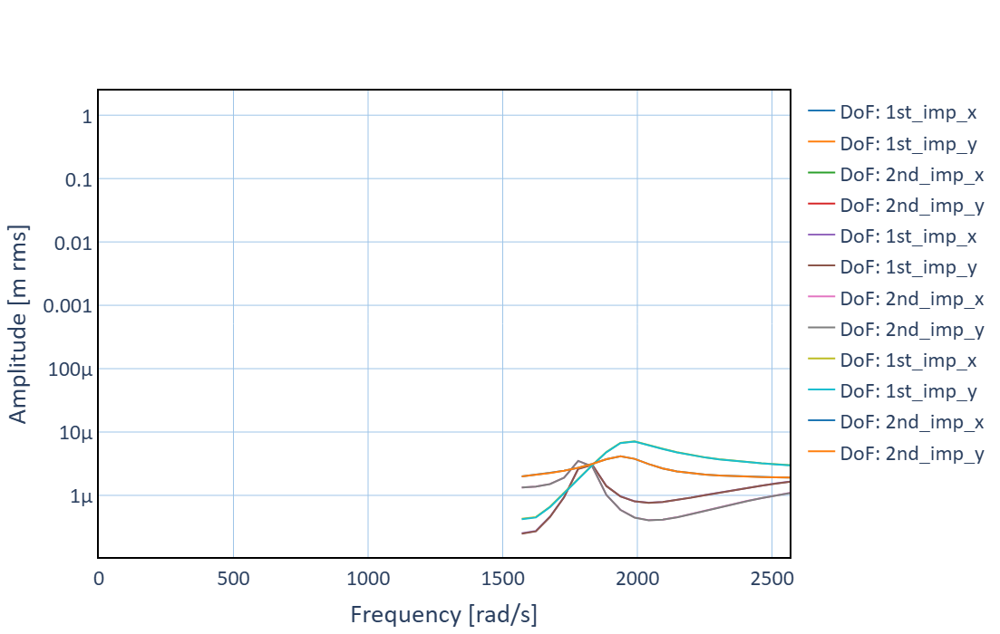

In [13]:
fig = res.plot_frf(['1st_imp_x', '1st_imp_y', '2nd_imp_x', '2nd_imp_y'])

fig2 = res.linear_results.plot_frf(dof=['1st_imp_x', '1st_imp_y', '2nd_imp_x', '2nd_imp_y'],
                                          whirl='unbalance', 
                    #    frequency_units='rpm'
                       )
fig2.add_trace(res.rigid_results.plot_frf(dof=['1st_imp_x', '1st_imp_y', '2nd_imp_x', '2nd_imp_y'],
                                          whirl='unbalance', 
                            #    frequency_units='rpm'
                               ).data[0])
fig2.add_trace(res.rigid_results.plot_frf(dof=['1st_imp_x', '1st_imp_y', '2nd_imp_x', '2nd_imp_y'],
                                          whirl='unbalance', 
                            #    frequency_units='rpm'
                               ).data[1])
fig2.add_trace(res.rigid_results.plot_frf(dof=['1st_imp_x', '1st_imp_y', '2nd_imp_x', '2nd_imp_y'],
                                          whirl='unbalance', 
                            #    frequency_units='rpm'
                               ).data[2])
fig2.add_trace(res.rigid_results.plot_frf(dof=['1st_imp_x', '1st_imp_y', '2nd_imp_x', '2nd_imp_y'],
                                          whirl='unbalance', 
                            #    frequency_units='rpm'
                               ).data[3])
for d in fig2.data:
    d.y = f[27] * d.y # .5 * d.y * 1e-6 * 6350 * r.rotor_solo_disks.m / (f_0 * 60 / (2 * np.pi))

    fig.add_trace(d)

fig.show()

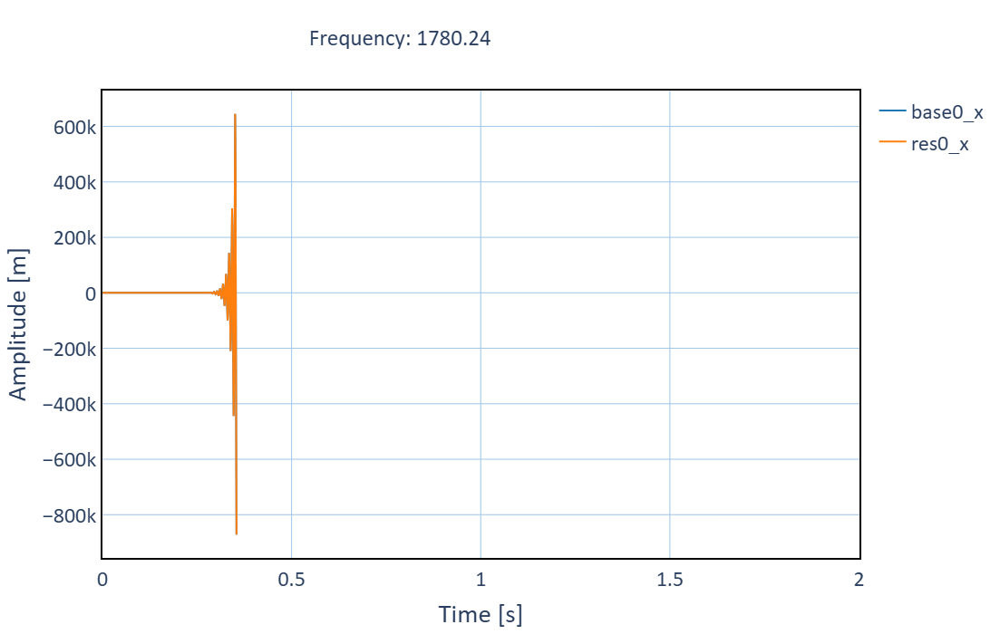

In [11]:
res.plot_waveform(frequency=1780,dof=['base0_x', 'res0_x'])

In [10]:
f[27]

np.float64(5.5128046541602105e-06)

In [14]:
res.ddl[0]

{'time': array([0.00000000e+00, 2.29173828e-05, 4.58347657e-05, ...,
        1.99954165e-01, 1.99977083e-01, 2.00000000e-01], shape=(8728,)),
 '1st_imp_x': array([-3.89759607e-07, -3.88984103e-07, -3.87706052e-07, ...,
        -3.89797503e-07, -3.90031035e-07, -3.89759607e-07], shape=(8728,)),
 'solver': 'hb',
 '1st_imp_y': array([-1.33239282e-08, -2.71148125e-08, -4.08703626e-08, ...,
         1.42925869e-08,  4.84482192e-10, -1.33239282e-08], shape=(8728,)),
 '2nd_imp_x': array([-1.53443302e-06, -1.49000391e-06, -1.44364803e-06, ...,
        -1.61728209e-06, -1.57687751e-06, -1.53443302e-06], shape=(8728,)),
 '2nd_imp_y': array([-1.20752645e-06, -1.26159285e-06, -1.31402449e-06, ...,
        -1.09477153e-06, -1.15189532e-06, -1.20752645e-06], shape=(8728,))}

In [15]:
omg = 10
t = np.arange(0, 0.2, 0.0001)
aux = np.vstack([np.ones(len(t))] +
                        [np.vstack([np.sin(omg * i / r_nl.nu * t),
                                    np.cos(omg * i / r_nl.nu * t)]) for i in range(1, r_nl.n_harm + 1)])

In [6]:
2728/r_nl.ndof

11.0

In [16]:
aux.shape

(11, 2000)

In [21]:
z = np.ones(r_nl.ndof * (r_nl.n_harm * 2 + 1))
z = z.reshape((len(z), 1))
np.sum(aux * z[0::r_nl.ndof], axis=0).shape

(2000,)

In [9]:
t.shape

(2000,)

In [12]:
aux.shape

(20001,)